# 1. Exercise:

## 1.1. Introduction and Imports

- Load Exercise_01_Template.ipynb
- Save this file as Exercise_01_Group_xx.ipynb where xx is your group number.
- Put your Group number and your names in the first paragraph of the file.
- Groups have to have at least 2 members and a maximum of 3 members.

In [1]:
# Group Number: 03
# Group Members: Simon Grünewald, Kurt Kilian Eifler, Moritz Ladwig 
# Last Change: 18.05.20 KKE

# Imports
import numpy as np
from matplotlib import pyplot as plt
import matplotlib
import numpy.matlib as ml
import imageio
import skimage.transform
import scipy

%matplotlib inline
# Set default figure size as plots and images are displayed very small otherwise (parameters are intended to represent width and height in inches)
matplotlib.rcParams['figure.figsize'] = (8.0, 8.0)

#print(plt.style.available)
plt.style.use('dark_background')
print('Hello Filmtechnique')

Hello Filmtechnique


## 1.2. Load and display an image
- Load the image Exercise_01_Peppers.png into Python and display it
- The result should look as follows:

<img src="Exercise_01_Result_1_2.png" alt="Result" style="width: 256px;"/>

(384, 512, 3)

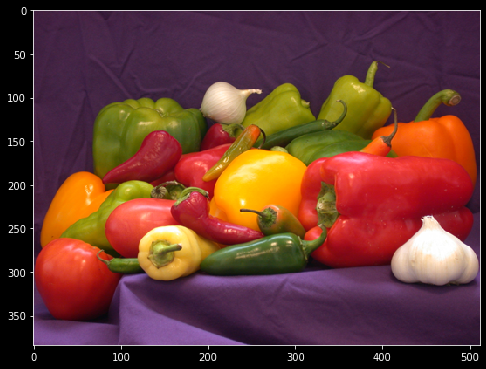

In [3]:
# Read "Exercise_01_Peppers.png"
peppersImg = plt.imread('Exercise_01_Peppers.png')


# Plot peppersImg
plt.imshow(peppersImg)
# Your code here

# Output image size
peppersImg.shape

In [4]:
# Cool, let's try some:
print( "Max: " + str( peppersImg.max()  ) )
print( "Min: " + str( peppersImg.min()  ) )
print( "Mean: " + str( peppersImg.mean() ) )

Max: 1.0
Min: 0.0
Mean: 0.3200149


## 1.3 Let's play with indexing - display a white square and circle on black background
- Create a black image with a white square in the middle by using indexing.
- The result should look as follows:

<img src="Exercise_01_Result_1_3_Square.png" alt="Result" style="width: 256px;"/>

(200, 200)

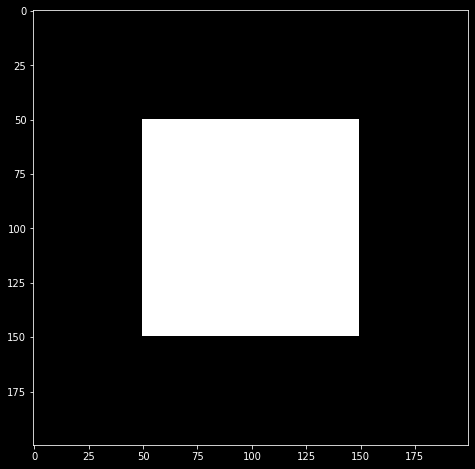

In [5]:
# Initialize Black image of size 200*200 pixel
squareImg = np.zeros( (200, 200) )

# Add White square
for i in range(50,150):
    for j in range(50,150):
        squareImg[i,j] = True

# Plot
plt.imshow(squareImg, cmap='gray', vmin=0.0, vmax=1.0)
squareImg.shape

- Now do the same but display a white circle
- The result should look as follows:

<img src="Exercise_01_Result_1_3_Circle.png" alt="Result" style="width: 256px;"/>

(200, 200)

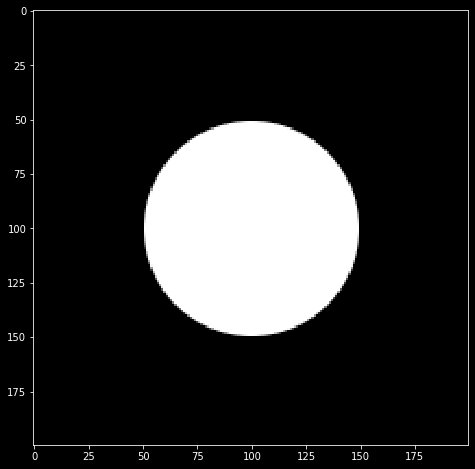

In [6]:
# Initialize Black image of size 200*200 pixel
circleImg = np.zeros( (200, 200) )

# Create variable which contain the x and y position in the image
xPos = np.tile( np.reshape( np.arange(0,200), ( 200, 1 ) ), [1, 200 ] )
yPos = np.tile( np.reshape( np.arange(0,200), ( 1, 200 ) ), [200, 1 ] )

#print(xPos)
#print(yPos)

# Add a white circle by setting all pixel inside the circle to 1.0. (Conditional indexing)
# Die Differenz von 100 zu xPos bzw. yPos ist die Verschiebung zum Mittelpunkt.

""" for i in range(200):
    for j in range(200):
        if ml.sqrt((xPos[i,j]-100)**2 + (yPos[i,j]-100)**2) <= 50:
            circleImg[xPos[i, j], yPos[i,j]] = 1 """

# hat auch ohne xPos und yPos funktioniert, hat es das nicht unnötig kompliziert gemacht?

circleImg = 50 - np.sqrt( np.power(xPos-100.0,2.0) + np.power(yPos-100.0,2.0) )

# Plot
plt.imshow(circleImg, cmap='gray', vmin=0.0, vmax=1.0)
circleImg.shape

In [8]:
# By the way - how do I find methods like 'shape'?
#Ausgabe aller Methoden für die Bildfunktion
#dir( peppersImg )

(200, 200)

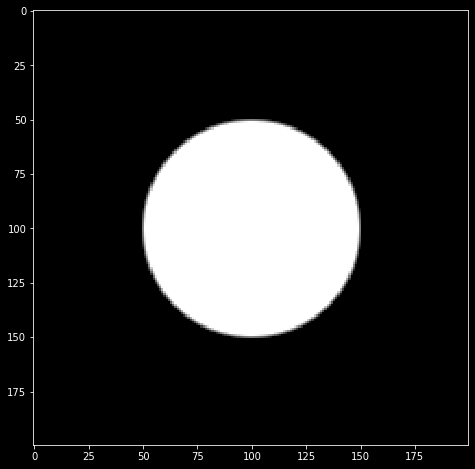

In [7]:
# Bonus: Do you have a simple idea how to render a smoother border?
#circleImg = # Your code here
""" for i in range(200):
    for j in range(200):
        if ml.sqrt((xPos[i,j]-100)**2 + (yPos[i,j]-100)**2) < 50:
            circleImg[xPos[i, j], yPos[i,j]] = 1
        elif ml.sqrt((xPos[i,j]-100)**2 + (yPos[i,j]-100)**2) <= 50:
            circleImg[xPos[i, j], yPos[i,j]] = 0.5 """
circleImg = np.clip(50 - np.sqrt( np.power(xPos-100.0,2.0) + np.power(yPos-100.0,2.0) ), -1.0,1.0 )
# Plot
plt.imshow(circleImg, cmap='gray', vmin=-1.0, vmax=1.0)
circleImg.shape

## 1.4. The sRGB Color Space
- Typical images like the file peppers.png are stored in sRGB color space.
- Load peppers.png into the variable img_sRGB.
- Add two horizontal gradients below the image, one from 0.4 to 0.6 and one from 0 to 0.1 both in 0…1 sRGB domain. See image on the right for an example.
- Display this image with different brightness offsets.
- Linearize this file according to the formula given in: https://www.w3.org/Graphics/Color/sRGB.html and save it into a variable called img_Linear.
- Display this linearized image. What needs to be done so that it looks correct again?
- Display this image at different brightness levels implementing brightness in linear domain.
- Is ‘+’ still the correct operation to implement brightness? No! Implement a better operator.

(128, 512, 3)

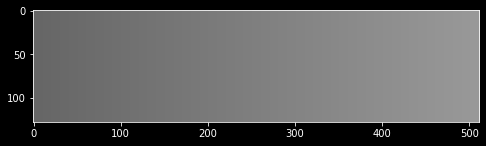

In [5]:
# Create a 128*512 pixel horizontal gradient from 0.4 to 0.6 in 0…1 sRGB domain.

gradient1 = np.zeros((128,512,3))
# For- Schleife ist ein Weg, aber nicht der richtige
'''for a in range(128):
    for b in range (512):
        for c in range (3):
            x = 0.4 +(0.2/512)*b
            gradient1[a,b,c] = x'''

# gradient1 = np.reshape(np.tile(np.reshape(np.tile(np.arange(0.4,0.6,(0.2/512)),128),[128,512]),3),[128,512,3],'F')
h = 512 #Debuge Code
v = 128 #Debuge Code
gradient1 = np.tile(np.reshape(np.linspace(0.4,0.6,h),(1,h,1)),[v,1,3])

# Code für arryausgabe
# np.linespace(0.4,0.6,512).shape

# Full intensity to those pixel's R channel
'''peppersImg[50:150 , : , 0] = 255 
plt.figure( figsize = (10,10))
plt.imshow(peppersImg)
plt.show()'''


# Plot gradient
plt.imshow( gradient1 )
gradient1.shape

In [21]:
# Create a 128*512 pixel horizontal gradient from 0.0 to 0.1 in 0…1 sRGB domain.
gradient2 = np.zeros((128,512,3))
gradient2 = np.reshape(np.tile(np.reshape(np.tile(np.arange(0.0,0.1,(0.1/512)),128),[128,512]),3),[128,512,3],'F')

# Load peppers.png into the variable peppersImg 
peppersImg = plt.imread('Exercise_01_Peppers.png')

# Concatenate all three images
img_sRGB = np.concatenate( ( peppersImg, gradient1, gradient2 ), axis=0 )

# Plot the combined Image
plt.imshow( img_sRGB )

NameError: name 'gradient1' is not defined

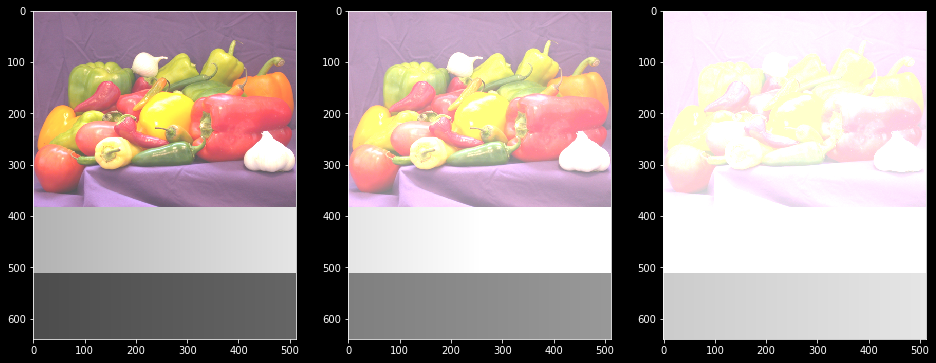

In [10]:
# Display with different brightness offsets

brightness1 = 0.3
brightness2 = 0.5
brightness3 = 0.8

plt.figure(figsize=(16,8))  # Alternative to figsize setting in the first code block
plt.subplot(1,3,1)
plt.imshow( np.clip( img_sRGB + brightness1, 0.0, 1.0) );
plt.subplot(1,3,2)
plt.imshow( np.clip( img_sRGB + brightness2, 0.0, 1.0) );
plt.subplot(1,3,3)
plt.imshow( np.clip( img_sRGB + brightness3, 0.0, 1.0) );

In [8]:
# Now implement the sRGB functions so that we can use them to convert our image to linear domain
# 3 Versions: Fröhlich, any (Error low values), ~less

#version2sRGB = 1 # 1 = Fröhlich, 2 = any, 3 = ~less

#if version == 1:
def sRGB2linear(x):
    result = np.zeros(x.shape)
    result[ x <= 0.0404482362771082 ] = x[ x <= 0.0404482362771082 ] / 12.92
    result[ x >  0.0404482362771082 ] = np.power( ( ( x[ x >  0.0404482362771082 ] + 0.055 ) / 1.055 ), 2.4)
    return result

def linear2sRGB(x):
    result = np.zeros(x.shape)
    result[ x <= 0.0031308 ] = x[ x <= 0.0031308 ]* 12.92
    result[ x >  0.0031308 ] = np.power( x[ x >  0.0031308 ], (1.0 / 2.4) ) * 1.055 -0.055
    return result



In [12]:
# Eigene Version, leider sind die Werte nicht ganz Korrekt, Fehler liegt hier in dem .any() oder .all(). Es werden nicht alle Werte bearbeitet, die Abfrage ist somit fehlerhaft.
'''#if version == 2:
def linear2sRGB(x):
    if x. any() > 0.0031308:
        sRGB = 1.055 * (pow(x, (1.0 / 2.4))) - 0.055
    else:
        sRGB = 12.92 * x
    return sRGB

def sRGB2linear(x):
    if x.any() <= 0.0404482362771082:
        linear = x / 12.92
    else:
        linear = pow(((x + 0.055) / 1.055), 2.4)
    return linear
'''


'#if version == 2:\ndef linear2sRGB(x):\n    if x. any() > 0.0031308:\n        sRGB = 1.055 * (pow(x, (1.0 / 2.4))) - 0.055\n    else:\n        sRGB = 12.92 * x\n    return sRGB\n\ndef sRGB2linear(x):\n    if x.any() <= 0.0404482362771082:\n        linear = x / 12.92\n    else:\n        linear = pow(((x + 0.055) / 1.055), 2.4)\n    return linear\n'

In [8]:
#if version == 3:
def sRGB2linear(x):
    linear = x.copy()
    less = linear <= 0.0404482362771082
    linear[less] = linear[less] / 12.92
    linear[~less] = np.power((linear[~less] + 0.055) / 1.055, 2.4)
    return linear

    
def linear2sRGB(x):
    srgb = x.copy()
    less = x <= 0.0031308
    srgb[less] = x[less] * 12.92
    srgb[~less] = 1.055 * np.power(x[~less], 1.0 / 2.4) - 0.055
    return srgb
#else:
#    print('falsche Versionseingabe')

4.440892098500626e-16

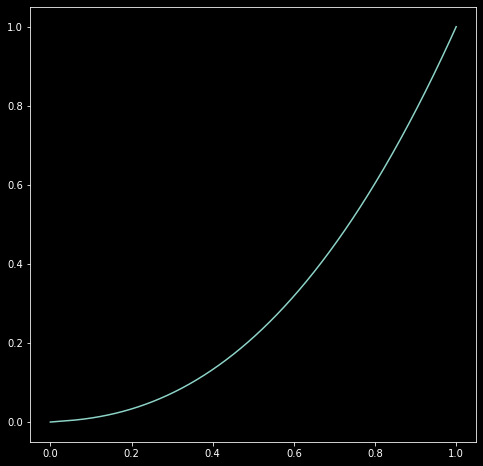

In [19]:
# Darstellung der Kurve zu Testzwecken
a = np.linspace(0,1,1000)
plt.plot(a, sRGB2linear(a) )
np.max(np.abs( a - sRGB2linear(linear2sRGB(a))))

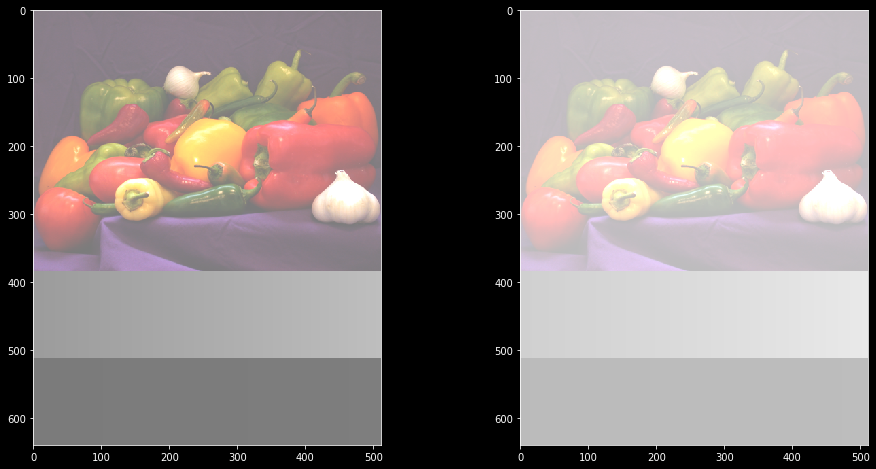

In [9]:
# No let's try to apply '+' as a brightness opaerator in linear domain:
brightness1 = 0.2
brightness2 = 0.5
img_Linear = sRGB2linear( img_sRGB )
plt.figure( figsize = (16,8) )  # Alternative to figsize setting in the first code block
plt.subplot(1,2,1)
plt.imshow( np.clip( linear2sRGB( img_Linear + brightness1 ), 0.0, 1.0 ) );
plt.subplot(1,2,2)
plt.imshow( np.clip( linear2sRGB( img_Linear + brightness2 ), 0.0, 1.0 ) );

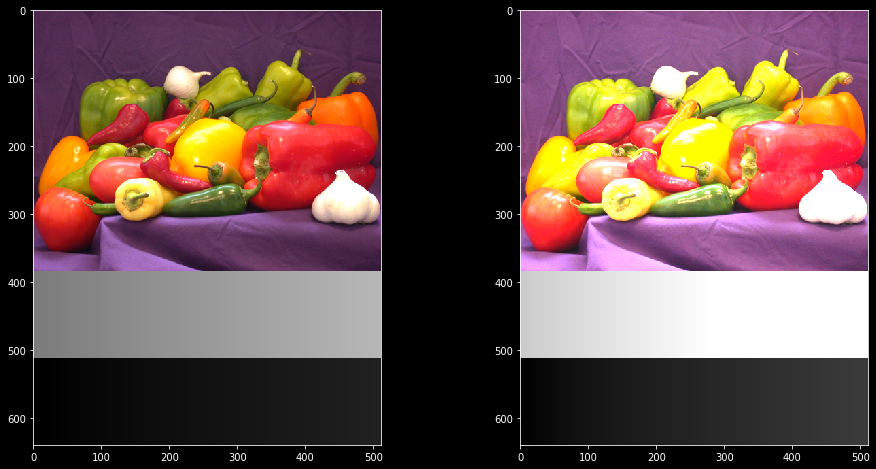

In [25]:
# Using the '+' operator does not work well. Exchange for a better operator and display

brightness1 = 1.5
brightness2 = 4.5
img_Linear = sRGB2linear( img_sRGB )
plt.figure( figsize = (16,8) )  # Alternative to figsize setting in the first code block
plt.subplot(1,2,1)
plt.imshow( np.clip( linear2sRGB( img_Linear * brightness1 ), 0.0, 1.0 ) );
plt.subplot(1,2,2)
plt.imshow( np.clip( linear2sRGB( img_Linear * brightness2 ), 0.0, 1.0 ) );
# Please explain your choice of operator in words and why it is a good match to '+' in perceptual domain.
# Die Helligkeitsverhältnisse der Farben müssen erhalten bleiben, deswegen sollten die Werte Multipliziert werden. Bei der Addition werden die Farbverhältnisse verzerrt.

## 1.5. Filtering in linear domain
Some operations must be performed in linear domain to get a realistic result.
- Load Exercise_01_Playground_c_Timo_Kunkel.exr.
- Display the image on your monitor.
- Use imfilter with the supplied filter kernel in pq and in linear domain. What do you observe?

In [9]:
# This functions provides read support for OpenEXR files. You only have to execute it once per computer.
imageio.plugins.freeimage.download()

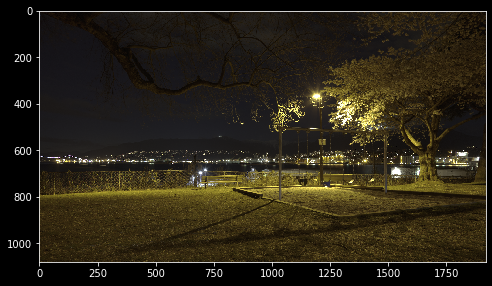

In [10]:
# Read typical HDR image from disk
linImg = imageio.imread("Exercise_01_Playground_c_Timo_Kunkel.exr")
# Convert to sRGB and display
sRGBImg = np.clip( linear2sRGB( linImg ), 0.0, 1.0 );
plt.imshow( sRGBImg );

1045.0


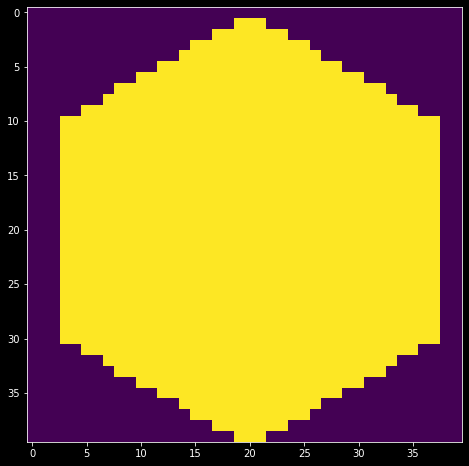

In [11]:
# Apply a "nice" aperture to the image for a 'bokeh-style' effect

# Import polygon function
from skimage.draw import polygon

# Init aperture
aperture = np.zeros((40, 40))
xPos = np.array([-1, -0.5, 0.5, 1, 0.5, -0.5, -1])*20+20
yPos= np.sqrt(3) * np.array([0, -0.5, -0.5, 0, 0.5, 0.5, 0])*20+20
xIdx, yIdx = polygon(xPos, yPos)

# Set pixels inside polygon to 1
aperture[xIdx, yIdx] = 1

print(np.sum(aperture))

# Normalize aperture
aperture = aperture/np.sum(aperture) 
plt.imshow( aperture );
#dir(skimage.transform)

#np.sum(aperture)

In [11]:
# Apply filter in sRGB domain and display
convolve_sRGBImg = np.zeros((linImg.shape))
for i in range(3):
    convolve_sRGBImg[:,:,i] = scipy.ndimage.convolve( sRGBImg[:,:,i], aperture )
plt.figure(figsize=(15,10))
plt.title('Filter applied in sRGB nonlinear domain')
plt.imshow( convolve_sRGBImg );

# print( "Max: " + str( convolve_sRGBImg.max()  ) )
# print( "Min: " + str( convolve_sRGBImg.min()  ) )
# print( "Mean: " + str( convolve_sRGBImg.mean() ) )

NameError: name 'aperture' is not defined

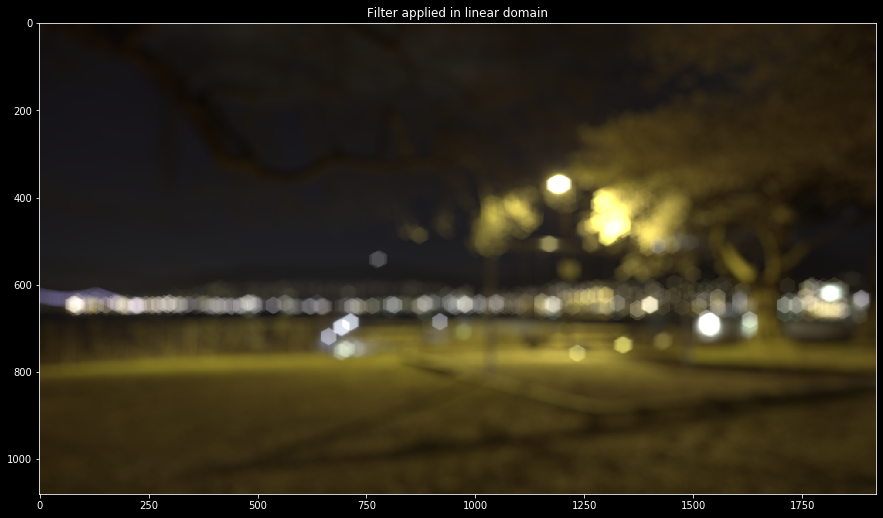

In [47]:
# Apply filter in linear domain and display
convolve_linImg = np.zeros((linImg.shape))
for i in range(3):
    convolve_linImg[:,:,i] = scipy.ndimage.convolve( linImg[:,:,i], aperture )
plt.figure(figsize=(15,10))
plt.title('Filter applied in linear domain')
plt.imshow( np.clip( linear2sRGB( convolve_linImg ), 0.0, 1.0 ) );

# Explain why the 'Bokeh' Effect can only be simulated in linear domain
# Der Filter errechnet aus den Umliegenden Pixeln ein neues Pixel, dabei werden die Werte der einzelnen Pixel bsp. zu 1/3 gewichtet. Da die Wert im sRGB Farbraum nicht linear verteilt sind, wirkt der Filter z.B. auf helle Partien im Linearen Raum anders. 
# Hierbei ist der Kontrast zwischen Hell und Dunkel entscheident. Siehe Skizze im nächsten Codeblock.

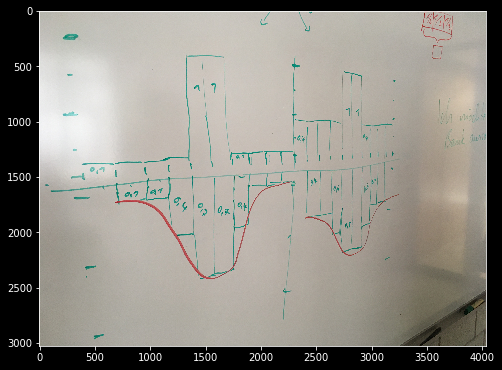

In [12]:
#Skizze zur erklärung:

erklaerImg = plt.imread('skizze_filter.JPG')
plt.imshow(erklaerImg)


2756.0


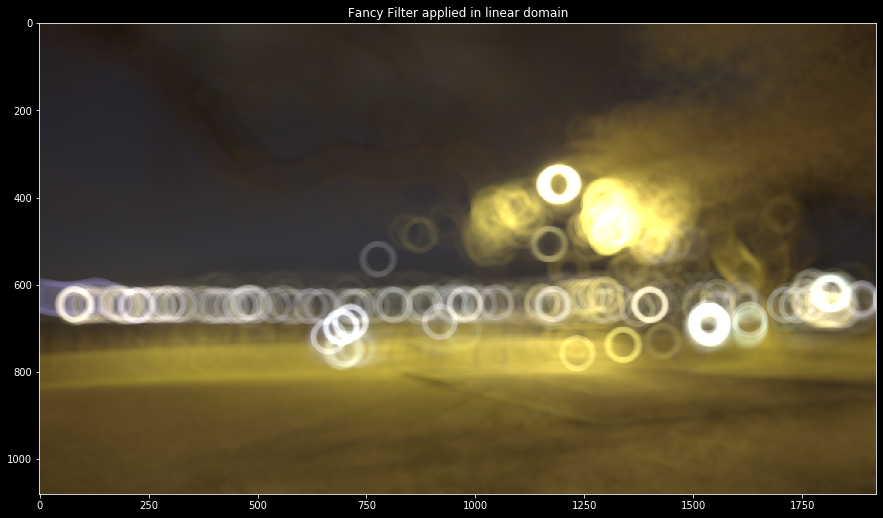

In [13]:
# Bonus: Play with different apertures, e.g. stars, rings, hearts,...

# Import circle and morph function
from skimage import morphology 
from skimage.draw import circle_perimeter

#init Aperture
circle = np.zeros((100, 100))
rr, cc = circle_perimeter(50, 50, 35)
circle[rr, cc] = 1
aperture_fancy = morphology.dilation(circle, morphology.disk(radius=6))

# test Normalizer
print(np.sum(aperture_fancy) )

# Normalize aperture
aperture_fancy = aperture_fancy/1024
#plt.imshow( aperture_fancy );

# Apply filter in linear domain and display
convolve_linImg = np.zeros((linImg.shape))
for i in range(3):
    convolve_linImg[:,:,i] = scipy.ndimage.convolve( linImg[:,:,i], aperture_fancy )
plt.figure(figsize=(15,10))
plt.title('Fancy Filter applied in linear domain')
plt.imshow( np.clip( linear2sRGB( convolve_linImg ), 0.0, 1.0 ) );

## 1.6 Image quantization
Is it meaningful to talk about image quantization without referencing if the image is coded in linear or
perceptual domain?
- Quantize the image from 1.4. (including the ramps) in both domains, linear and sRGB to bit depths between 4 and 16 bits.
- How many bits are needed in each domain for a visually transparent display?
- Just for your information: Most DSLRs quantize with 12bits or 14bit in linear sensor domain. Is this better compared to 8bits of tonal resolution in sRGB domain?

In [12]:
#Picture Import
peppersImg = plt.imread('Exercise_01_Peppers.png')

# Write formula for quantization

def quantize( img,bitDepth ):
    return np.round(img * ( np.power( 2, bitDepth-1 ) ) ) / ( np.power( 2, bitDepth-1 ) ) #R return # Your code here
# Formel
# roundet = x*2pow(y-1)/2pow(y-1)

In [13]:
# What bit-depth is needed for visually tranparent quantization in sRGB domain?
# Plot our 'img_sRGB' quantized in sRGB domain quantized to 1...8 bits

for bitDepth in range(1,9):
    plt.figure(figsize=(15,10))
    plt.subplot(1,2,1)
    plt.title('Original Image')
    plt.imshow(img_sRGB)
    plt.subplot(1,2,2)
    plt.title('Bitdepth: ' + str( bitDepth) )
    plt.imshow( quantize(img_sRGB , bitDepth) )
    plt.show()

# What is the nimimun bit-depth that can be used for quantizing the image without artifacts? 
# Is this the same value for the gradients compared to the image?
# The image shows on 6 Bit a quite good result, but on the gradient it's not accaptable. Even in 8 Bit we see a posteriastion and artefacts in the gradient.

NameError: name 'img_sRGB' is not defined

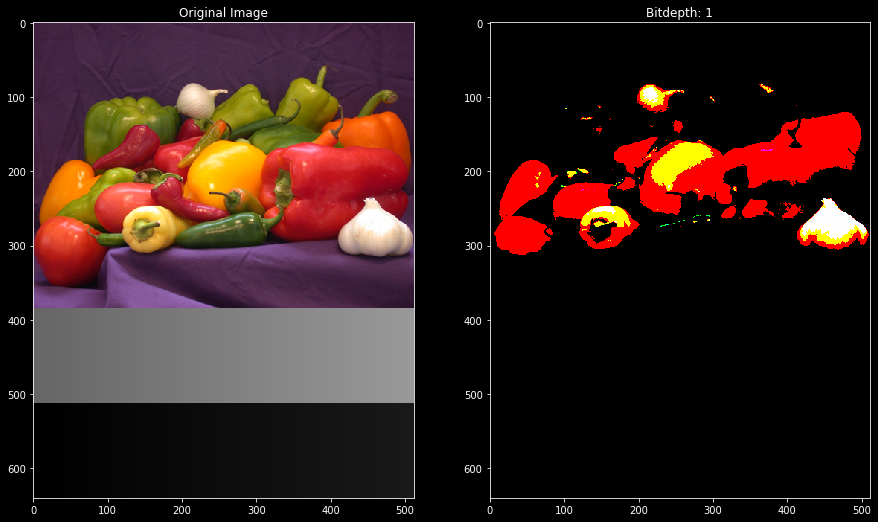

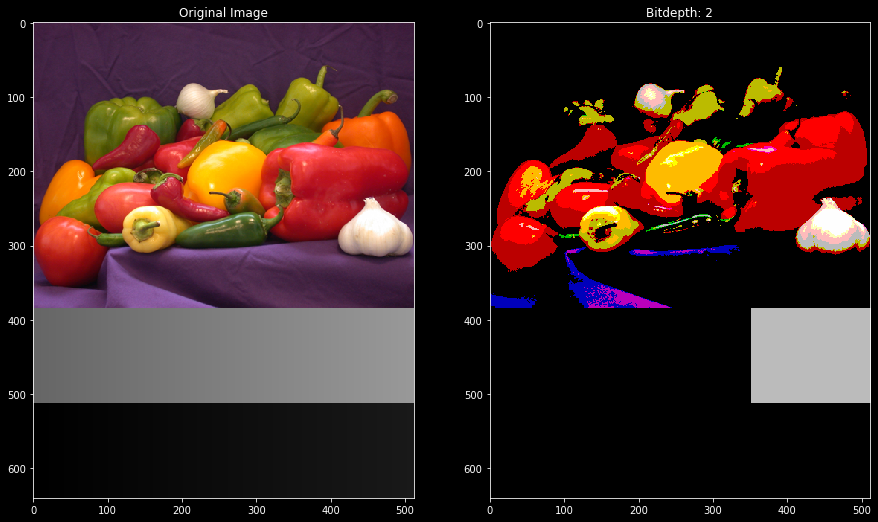

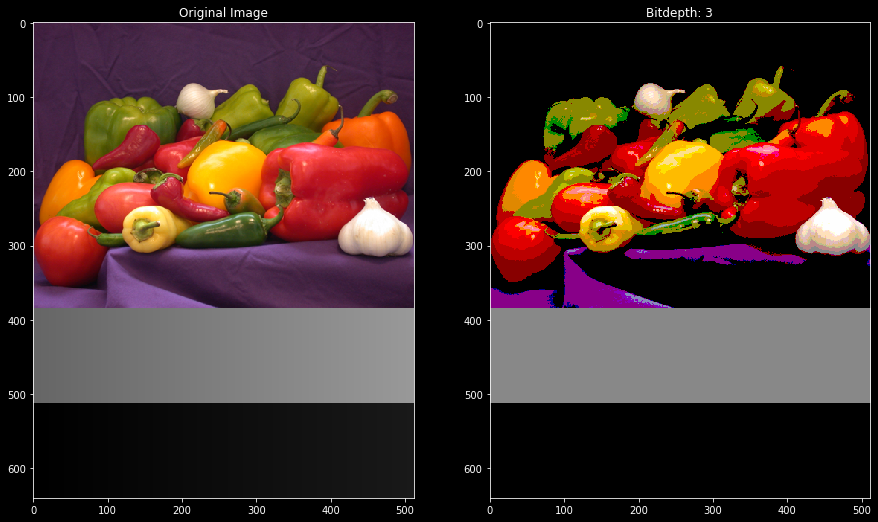

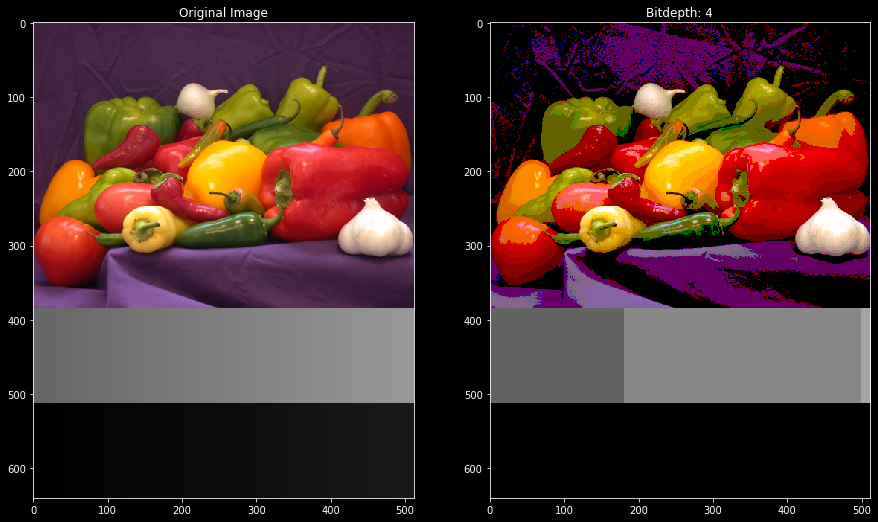

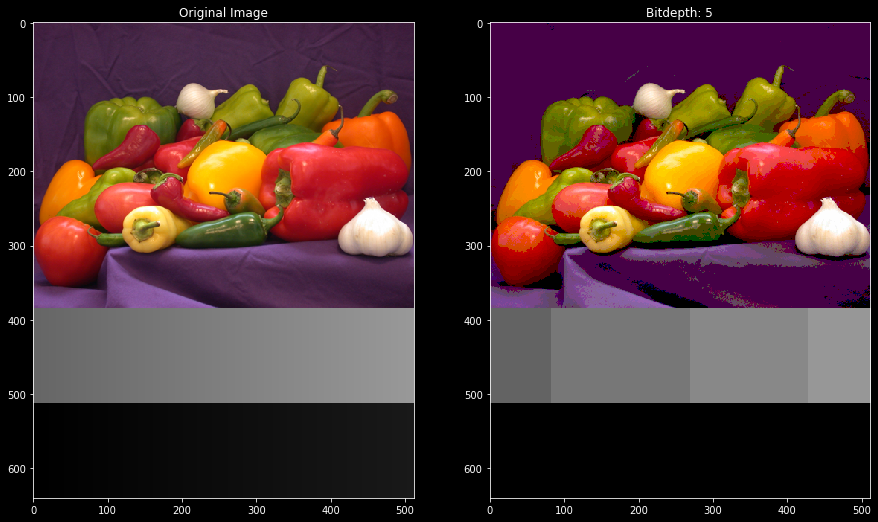

...

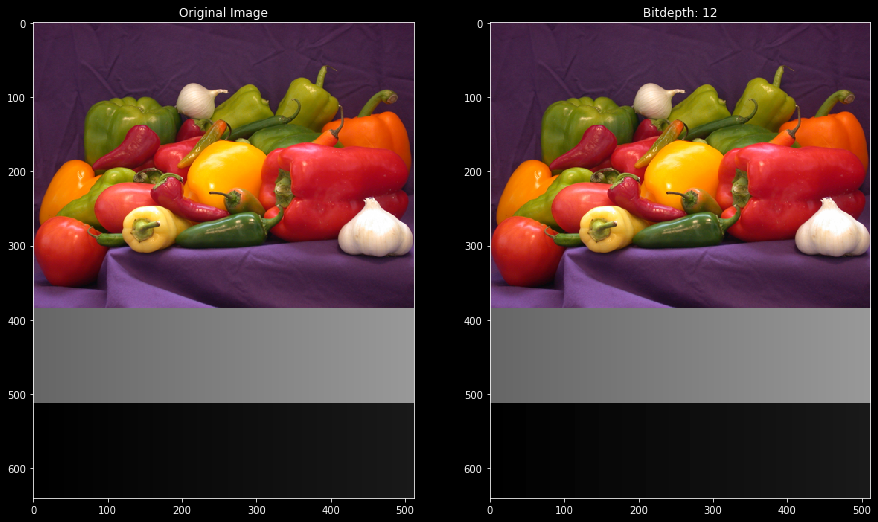

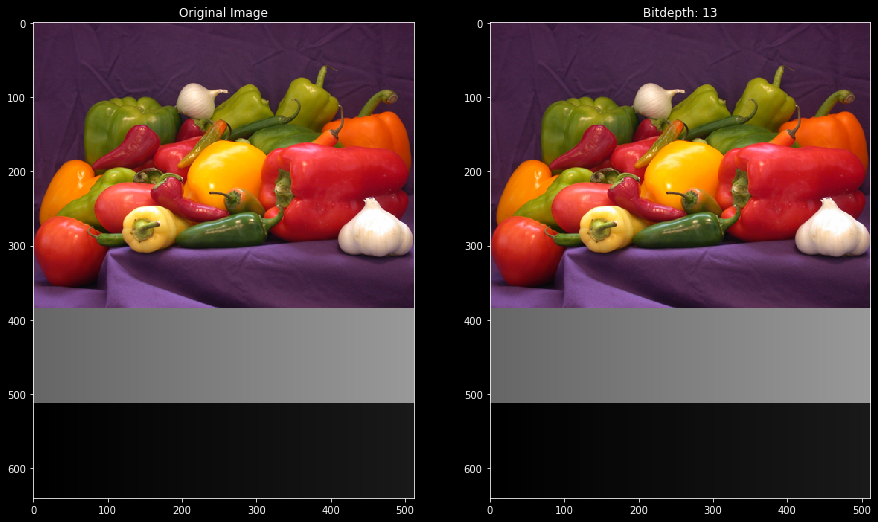

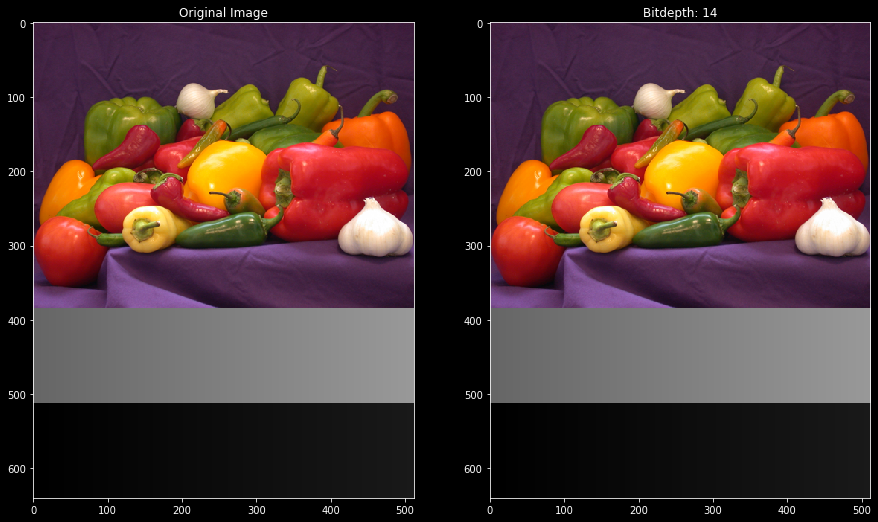

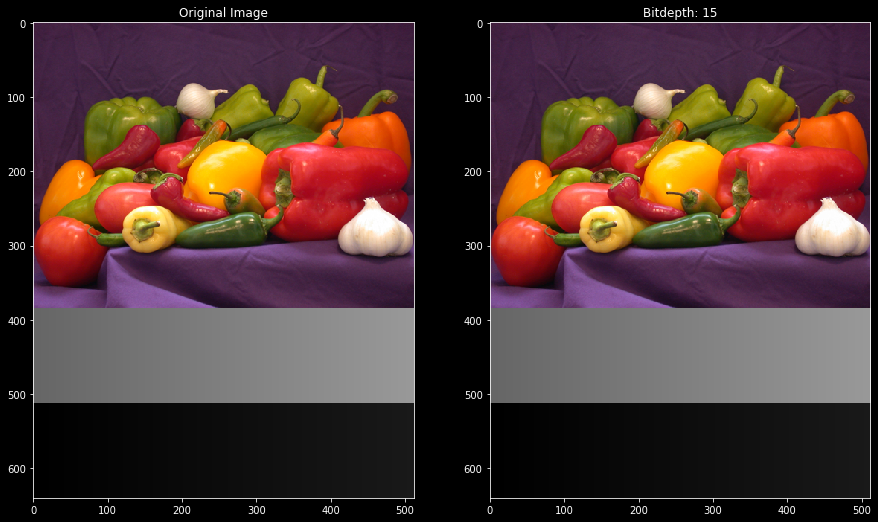

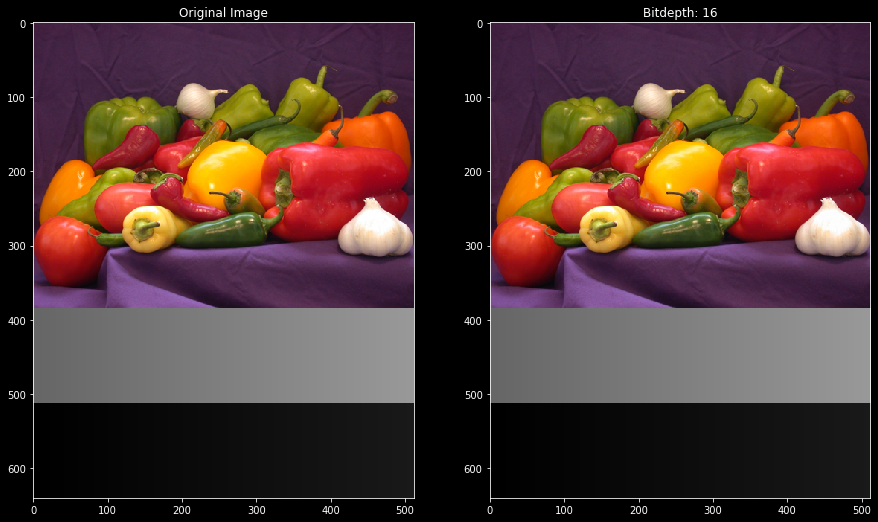

In [34]:
# What bit-depth is needed for visually tranparent quantization in linear domain?
# Plot our 'img_sRGB' quantized in linear domain quantized to 1...16 bits

for bitDepth in range(1,17):
    plt.figure(figsize=(15,10))
    plt.subplot(1,2,1)
    plt.title('Original Image')
    plt.imshow(img_sRGB)
    plt.subplot(1,2,2)
    plt.title('Bitdepth: ' + str( bitDepth) )
    plt.imshow( linear2sRGB(quantize( img_Linear, bitDepth) ))
    plt.show()
# What is the nimimun bit-depth that can be used for quantizing the image without artifacts? 
# Is this the same value for both gradients

## 1.7 Dependency of quantization artifact visibility on noise 
The minimum contrast visibility is highly dependent on noise. Find the needed tonal resolution
depending on Gaussian noise before and after quantization.
- Create two 1024 pixel wide horizontal ramps, one from 0 to 0.1 and one from 0.5 to 0.6 in sRGB 0…1 domain.
- Display this gradient quantized to 8bit.
- Find the needed tonal resolution (quantization bit depth) to display this gradient without banding artifacts on your monitor.
- Display the image and the gradient adding Gaussian noise with a standard deviation of one 8bit code value (1/255) before quantization. Which bit depth is now needed?
- Display the image and the gradient adding Gaussian noise with a standard deviation of one 8bit code value (1/255) after quantization. Which bit depth is now needed?
- Explain why adding noise before quantization has a different effect compared to adding noise after quantization.
- Simulate the photon shot noise of a typical video camera with a full well capacity of 3000 photons per sensor element and assess the needed tonal resolution (quantization bit depth) for images acquired with such a camera if the sensor would not introduce any additional noise to the photon shot noise you simulated.
- Why does the gradient need a different bit-depth compared to the image?
- How does this change your assessment of the needed bit-depth for linear RAW-camerafootage from exercise 1.6?

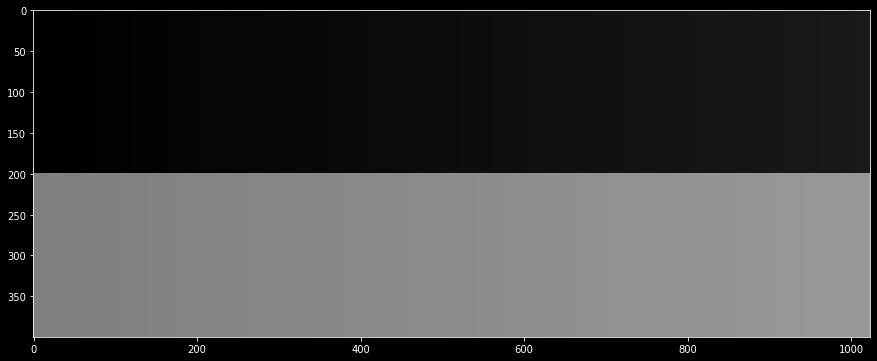

In [15]:
# Create horizontal ramp from 0 to 0.1 and 0.5 to 0.6

w = 1024
h = 200
# Ramp 1
ramp1 = np.reshape(np.tile(np.reshape(np.tile(np.linspace(0.0,0.1,w),h),[h,w]),3),[h,w,3],'F')

# Ramp 2
ramp2 = np.reshape(np.tile(np.reshape(np.tile(np.linspace(0.5,0.6,w),h),[h,w]),3),[h,w,3],'F')

ramp = np.concatenate( ( ramp1, ramp2 ), axis=0 )

ramp = np.concatenate( ( ramp1, ramp2 ), axis=0 )   
plt.figure( figsize = ( 15, 10 ) )      
plt.imshow( ramp )

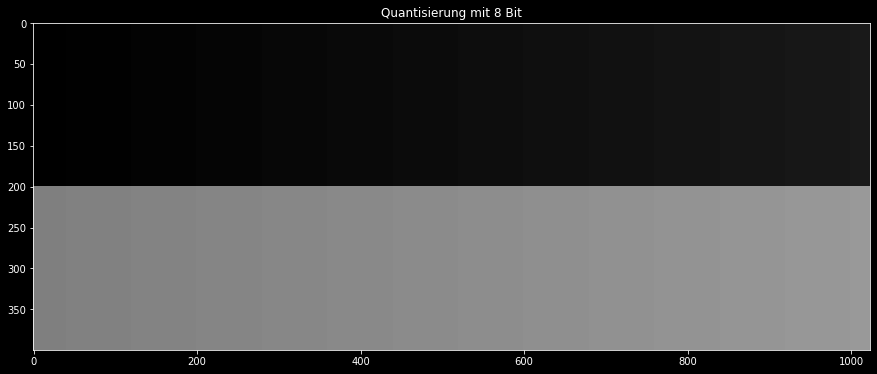

In [16]:
# Display quantized. Find the needed quantization for display without banding artifacts
myBitDepth = 8 # Adjust here

# Display
plt.figure( figsize = ( 15, 10 ) )
plt.title( 'Quantisierung mit '+ str( myBitDepth ) + ' Bit' )
plt.imshow( quantize( ramp, myBitDepth  ) )

# mindestens 10 Bit nötig, um im Schwarz (fast) keine Kanten zu sehen

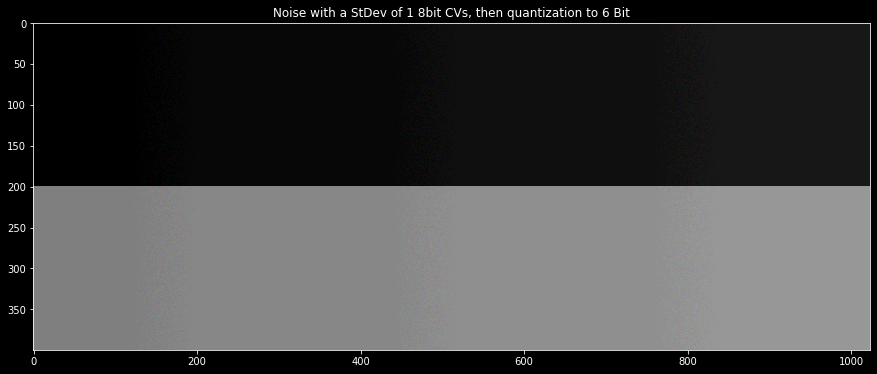

In [18]:
# Add gaussian noise with a standard deviation of one 8bit code value (1/255)
# Find the needed quantization for the ramp if this noise is added before quantization

# Add noise to the ramp
myBitDepth = 6 # Adjust here
myNoiseStDevIn8BitCVs = 1

# Bei 8 Bit verrauschen sich die Kanten so, dass sie kaum mehr wahrnehmbar sind.

# Add noise to ramp
randRamp = ramp + ((np.random.rand(400,1024,3).reshape(400,1024,3)-0.5)/128)


# qunatize Ramp with added noise
randRampQuantized = quantize( randRamp, myBitDepth)

# Display
plt.figure(figsize=(15,10))
plt.title( 'Noise with a StDev of ' + str(myNoiseStDevIn8BitCVs) + ' 8bit CVs, then quantization to '+ str( myBitDepth ) + ' Bit' )
plt.imshow( np.clip( randRampQuantized, 0.0, 1.0 ) );


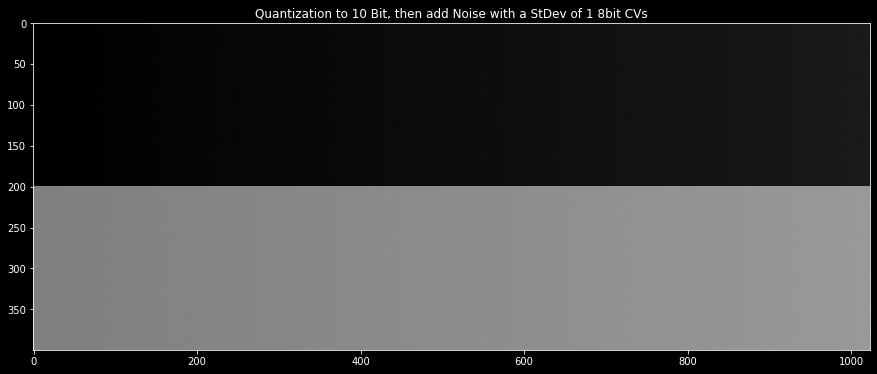

In [38]:
# Find the needed quantization for the ramp if this noise is added after quantization
myBitDepth = 10 # Adjust here
myNoiseStDevIn8BitCVs = 1

# Wenn das Rauschen erst nach dem Quantisieren hinzugefügt wird, muss die Farbinformation mit größerer Tiefe aufgelöst werden. Durch die Quantisierung wird ab einem präzisen Farbwert eine neue Farbe dargestellt. Das Rauschen verlagert diese Entscheidung von einer Kante auf einen Bereich. Fügt man das Rauschen erst danach hinzu ist die Kante deshalb noch sichtbar, weil die Quantisierung eine klare Kante hinterlassen hat.

# Quantize Ramp
quantRamp = quantize( ramp, myBitDepth )

# Add noise to already quantized ramp 
quantAndNoiseRamp = quantRamp + ((np.random.rand(400,1024,3).reshape(400,1024,3)-0.5)/128)

# Display
plt.figure(figsize=(15,10))
plt.title( 'Quantization to ' + str( myBitDepth ) + ' Bit, then add Noise with a StDev of ' + str(myNoiseStDevIn8BitCVs) + ' 8bit CVs' )
plt.imshow( np.clip( quantAndNoiseRamp, 0.0, 1.0 ) );

In [20]:
#Now simulate a typical video camera with a full well capacity of 10000 photons per sensor element.

# Convert img from sRGB to linear
img_Linear = sRGB2linear( img_sRGB )

NameError: name 'img_sRGB' is not defined

In [19]:
# Add poisson distibuted photon shot noise assuming white equals 3000 photons
# Reference: HPA 2015, 4k-HDR-Imagers, Dr Peter Centen

# Add poisson Noise (skimage.util.random_noise) may be useful
img_LinearPNoise = skimage.util.random_noise(img_Linear * 3000, mode='poisson', seed=None, clip=True) /3000
# lineares Bild mit Photonenanzahl multiplizieren und im nachhinein wieder dividieren.

plt.figure(figsize=(15,10))
plt.imshow( np.clip( linear2sRGB( img_LinearPNoise ), 0.0, 1.0) );

NameError: name 'img_Linear' is not defined

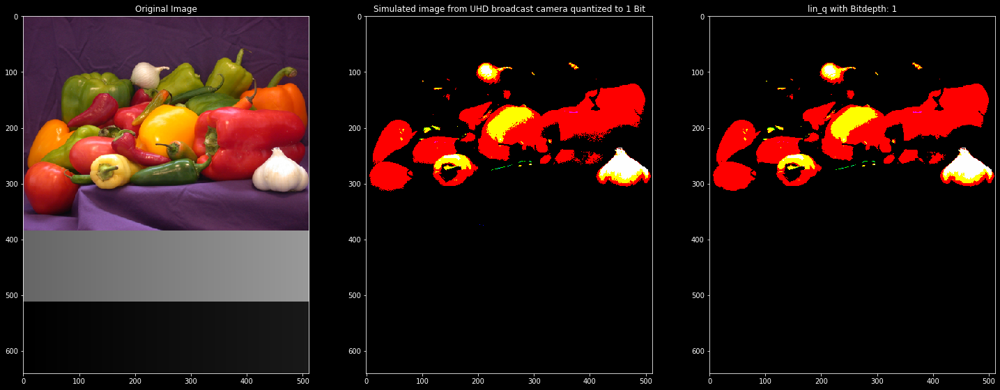

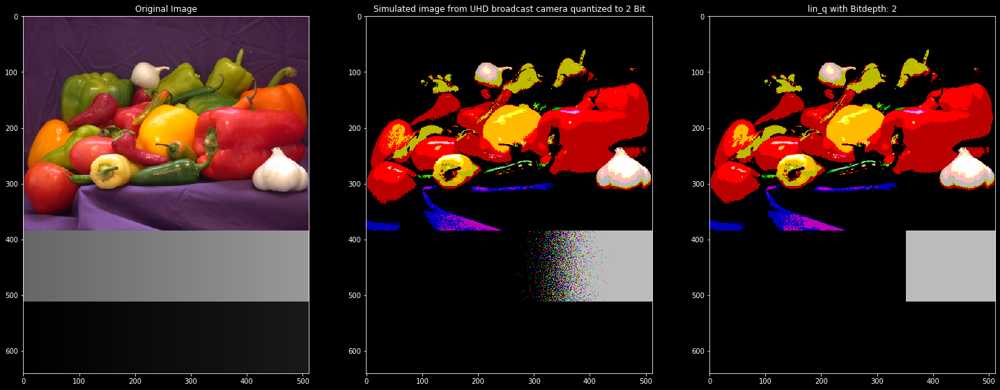

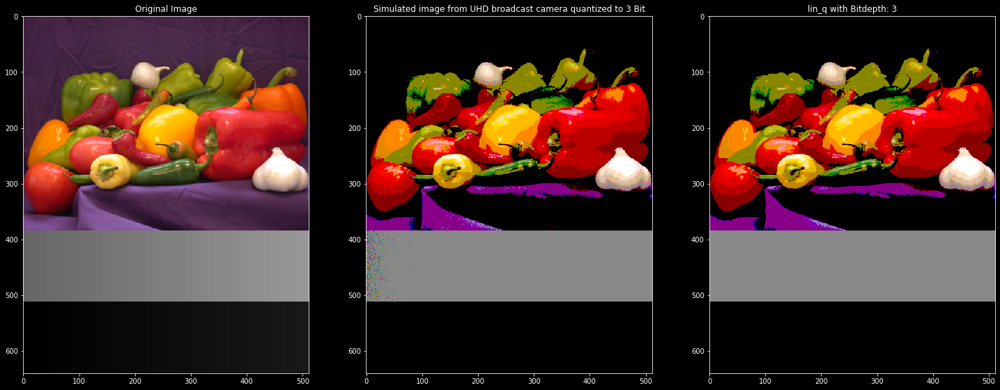

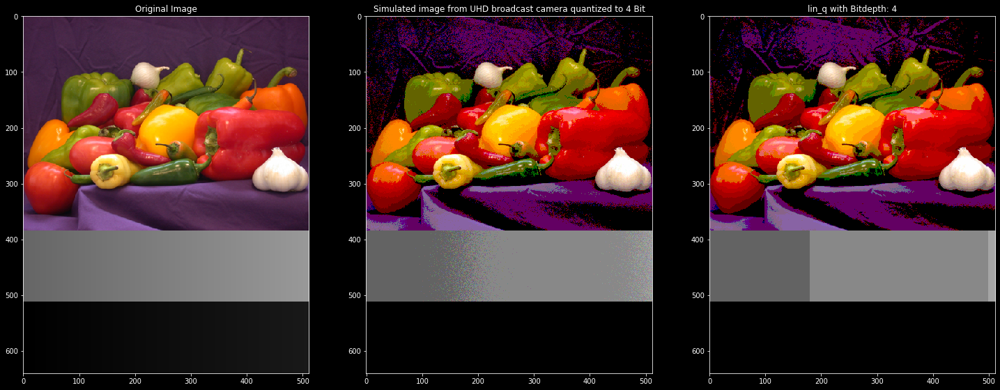

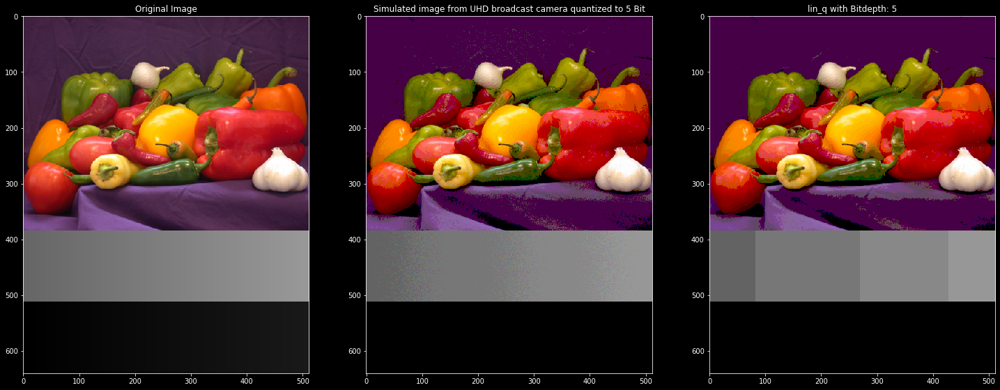

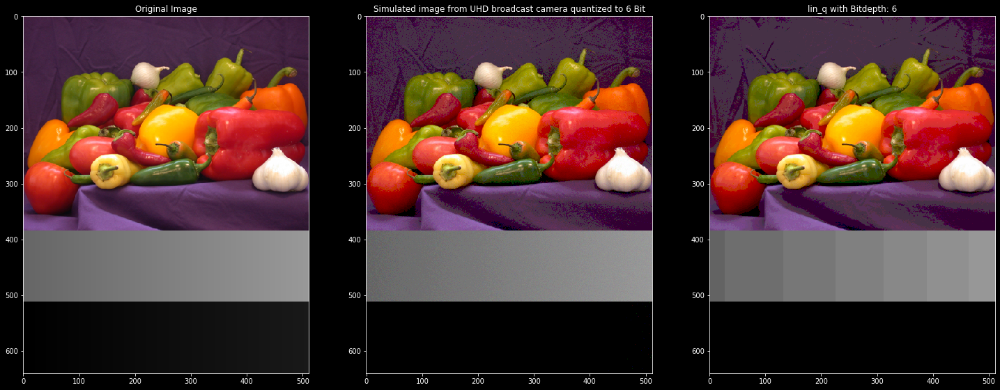

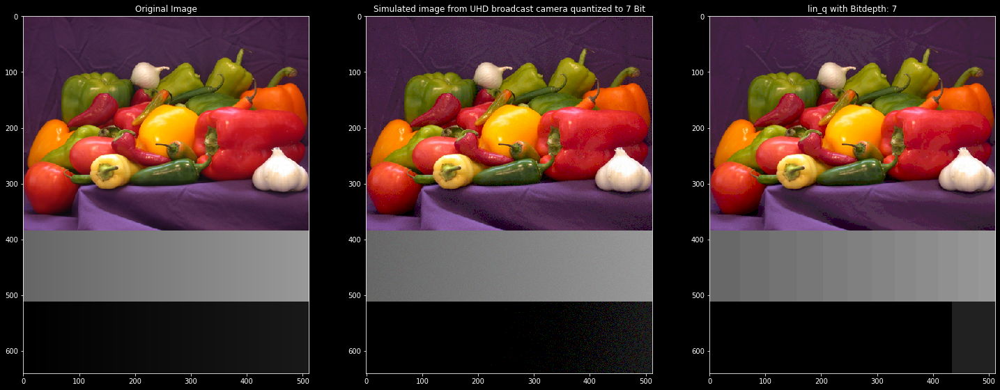

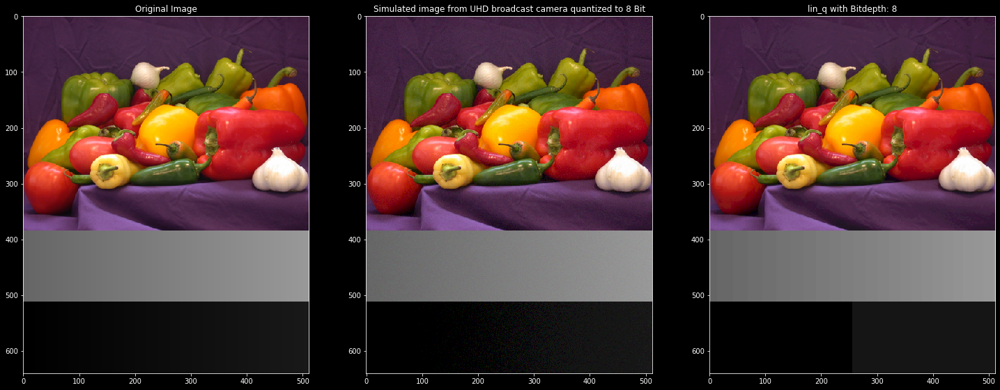

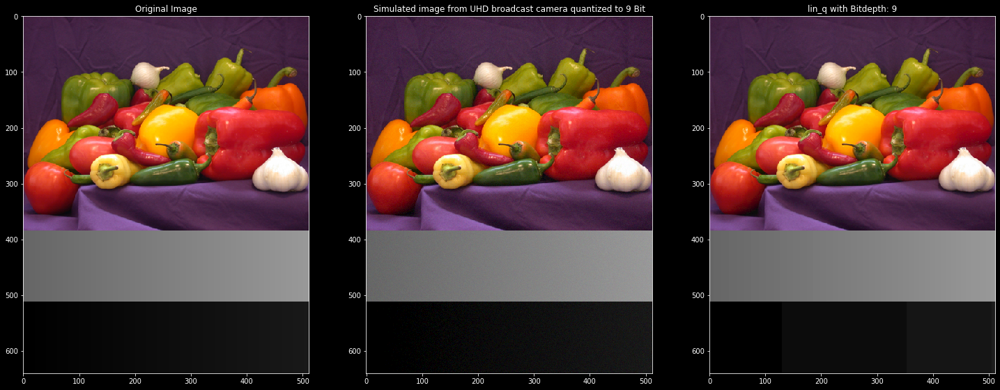

In [18]:
# Find out which minimum quantization is needed for lossless display of broadcast imagery
myBitDepth = 10 # Adjust here

# Qunatize Image with added photon shot noise
def img_LinearPNoiseQuantized (valueBit):
    return linear2sRGB(quantize( img_LinearPNoise, valueBit))

# Display
#Alte Vorgabe von Hr. Fröhlich
""" plt.figure( figsize = (15,10) )
plt.title( 'Simulated image from UHD broadcast camera quantized to '+ str( myBitDepth ) + ' Bit' )
plt.imshow(img_LinearPNoiseQuantized) """

#Neue Vergleichsausgabe für die Gegenüberstellung der einzelnen Bitraten.
for bitDepth in range(1,myBitDepth):
    plt.figure(figsize=(25,10))
    plt.subplot(1,3,1)
    plt.title('Original Image')
    plt.imshow(img_sRGB)
    plt.subplot(1,3,2)
    plt.title('Simulated image from UHD broadcast camera quantized to '+ str( bitDepth ) + ' Bit' )
    plt.imshow(img_LinearPNoiseQuantized(bitDepth)) # Rückconvertierung in sRGB darf nicht vergessen werden, Aufruf der linea2sRGB und des Qantisierers.
    plt.subplot(1,3,3)
    plt.title('lin_q with Bitdepth: ' + str( bitDepth) )
    plt.imshow( linear2sRGB(quantize( img_Linear, bitDepth) ) )
    plt.show()

# Explain how these findings change your assessment of the needed bit-depth for
# linear RAW camera footage from exercise 1.6?
# Aus der Versuchen ergibt sich für uns eindeutig, dass für die Postproduktion ein höherer Bit Wert anstatt der 8 Bit Sinn macht, um mehr aus den Bildern heraus zu holen. Für die Ausstrahlung ist es jedoch kaum rentabel mehr als 8 Bit zu senden, da auch hier die Standards der Displays und Farbstandards die Ansicht beschränken. 8 Bit sind vollkommen ausreichend. Eine höhere Bitrate würde nur das Rauschen noch genauer darstellen.